<h1>HW5 - Generative Adversarial Networks (GANs)</h1>
<h3><font color=yellow>Total Points: 100</font></h3>



<font color=greeen>Please, name this file as HW5_Q7_{Student_ID}.ipynb</font>

<h2>Full Name: Amir Mohammad Babaei </h2>
<h2>Student ID: 402212399 </h2>

# Init

In [1]:
import os
import numpy as np
import matplotlib.pyplot as plt
import torch
import torch.nn as nn
import torch.nn.functional as F
from torch.autograd import Variable
from torchvision import datasets, transforms

In [2]:
# Data Preprocessing
transform = transforms.Compose([
    transforms.Resize(64),
    transforms.ToTensor()
])

# DataLoader
mnist_dataset = datasets.MNIST(root='./MNIST', train=True, transform=transform, download=True);
data_loader = torch.utils.data.DataLoader(dataset=mnist_dataset, batch_size=32, shuffle=True, num_workers=2);

100%|██████████| 9912422/9912422 [00:00<00:00, 80015918.70it/s]


Extracting ./MNIST/MNIST/raw/train-images-idx3-ubyte.gz to ./MNIST/MNIST/raw



100%|██████████| 28881/28881 [00:00<00:00, 103446365.35it/s]


Extracting ./MNIST/MNIST/raw/train-labels-idx1-ubyte.gz to ./MNIST/MNIST/raw



100%|██████████| 1648877/1648877 [00:00<00:00, 31573934.19it/s]


Extracting ./MNIST/MNIST/raw/t10k-images-idx3-ubyte.gz to ./MNIST/MNIST/raw



100%|██████████| 4542/4542 [00:00<00:00, 3791150.00it/s]


Extracting ./MNIST/MNIST/raw/t10k-labels-idx1-ubyte.gz to ./MNIST/MNIST/raw



# Part 1: Implementation of a Basic GAN

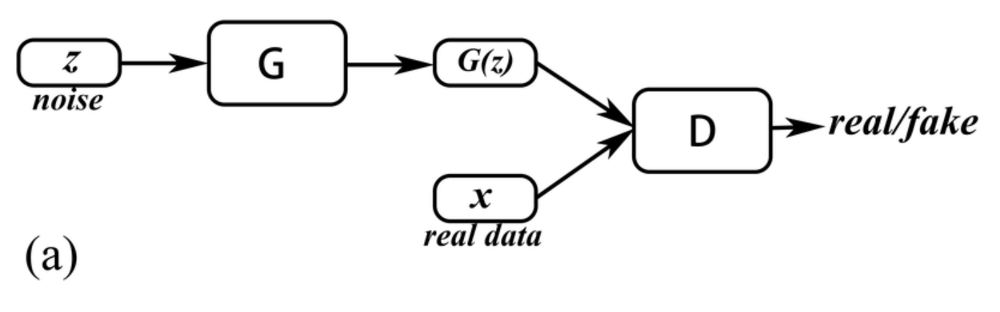

In this section, we will implement a basic Generative Adversarial Network (GAN) to generate fake images of handwritten digits using the MNIST dataset. The main components of this GAN include:

1. **Data Preprocessing**: Loading the MNIST dataset and applying necessary transformations.
2. **Generator**: A neural network that takes random noise as input and generates an image.
3. **Discriminator**: A neural network that takes an image as input and classifies it as real or fake.
4. **Training Loop**: Training the generator and discriminator in alternating steps.
5. **Results**: Visualizing the generated images and logging the training process.

Your task is to follow along with the provided code, understand the underlying concepts, and fill in any missing parts as instructed. Pay close attention to the network architectures, loss functions, and training dynamics to grasp how GANs function.


In [13]:
class Generator(nn.Module):
    def __init__(self, z_dim=100):
        super(Generator, self).__init__()
        self.main = nn.Sequential(

        # Hint: Use ConvTranspose2d, BatchNorm2d and proper activation layers
        # Your code here [10 score]
            nn.ConvTranspose2d(in_channels=z_dim, out_channels=128, kernel_size=4, stride=2, padding=0, bias=False),
            nn.BatchNorm2d(128),
            nn.ReLU(True),

            nn.ConvTranspose2d(in_channels=128, out_channels=64, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(64),
            nn.ReLU(True),

            nn.ConvTranspose2d(in_channels=64, out_channels=32, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(32),
            nn.ReLU(True),

            nn.ConvTranspose2d(in_channels=32, out_channels=16, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(16),
            nn.ReLU(True),

            nn.ConvTranspose2d(in_channels=16, out_channels=1, kernel_size=4, stride=2, padding=1, bias=False),
            nn.Tanh()

        )

    def forward(self, z):
        z = z.view(z.size(0), z.size(1), 1, 1)
        return self.main(z)

In [14]:
class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()
        self.main = nn.Sequential(
            # Hint: Use Conv2d, BatchNorm2d and proper activation layers
            # Your code here [10 score]
            nn.Conv2d(in_channels=1, out_channels=32, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(32),
            nn.LeakyReLU(0.2, inplace=True),

            nn.Conv2d(in_channels=32, out_channels=64, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(64),
            nn.LeakyReLU(0.2, inplace=True),

            nn.Conv2d(in_channels=64, out_channels=128, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(128),
            nn.LeakyReLU(0.2, inplace=True),

            nn.Conv2d(in_channels=128, out_channels=256, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(256),
            nn.LeakyReLU(0.2, inplace=True),

            nn.Conv2d(in_channels=256, out_channels=1, kernel_size=4, stride=1, padding=0, bias=False),
            nn.Sigmoid()

        )

    def forward(self, image):
        return self.main(image).view(-1, 1)

In [15]:
def save_fake_images(epoch, generator, fixed_z, batch_size, z_dim):
    sample_path = 'gan'
    if not os.path.exists(sample_path):
        os.makedirs(sample_path)

    fake_images = generator(fixed_z).view(batch_size, 1, 64, 64)
    plt.figure(figsize=(16, 4))
    for i in range(8):
        img = fake_images[i].cpu().detach().squeeze().numpy()
        img = (img + 1) / 2
        img = np.clip(img, 0, 1)

        plt.subplot(1, 8, i+1)
        plt.imshow(img, cmap='gray')
        plt.axis('off')

    plt.show()

In [16]:
def train_discriminator(discriminator, images, real_labels, fake_image, fake_labels, criterion, d_optimizer):

    # Hint: Pass real and fake images to discriminator and backporpagate sum of real and fake losses
    # Your code here [10 score]
    discriminator.zero_grad()
    outputs = discriminator(images)
    real_loss = criterion(outputs, real_labels)
    real_score = outputs

    outputs = discriminator(fake_image)
    fake_loss = criterion(outputs, fake_labels)
    fake_score = outputs

    d_loss = real_loss + fake_loss
    d_loss.backward()
    d_optimizer.step()

    return d_loss.item()

# def train_generator(discriminator, fake_image, real_labels, criterion, optimizer):
#     # Training to produce images that are classified as real
#     prob_fake = discriminator(fake_image)
#     g_loss = criterion(prob_fake, real_labels)

#     # Backpropagation and optimization
#     optimizer.zero_grad()
#     g_loss.backward()
#     optimizer.step()

#     return g_loss.item()

def train_generator(discriminator, fake_image, real_labels, criterion, g_optimizer):
    # Hint: Use discriminator to evaluate fake_image and calculate and backpropagate the generator loss (g_loss)
    # Your code here [10 score]
    generator.zero_grad()
    g_loss = criterion(discriminator(fake_image), real_labels)
    g_loss.backward()
    g_optimizer.step()

    return g_loss.item()

Epoch 1, Step 1871, D Loss: 0.0003, G Loss: 8.6015

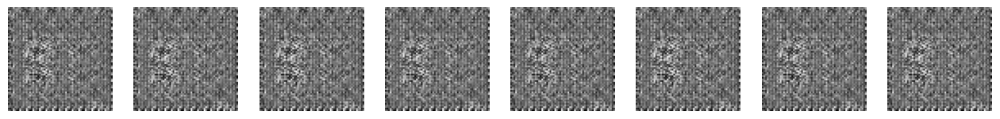

Epoch 2, Step 1871, D Loss: 0.0107, G Loss: 5.7963

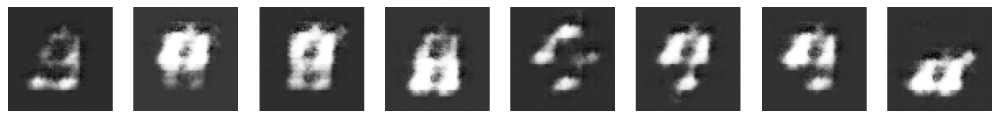

Epoch 3, Step 1871, D Loss: 0.0014, G Loss: 8.0125

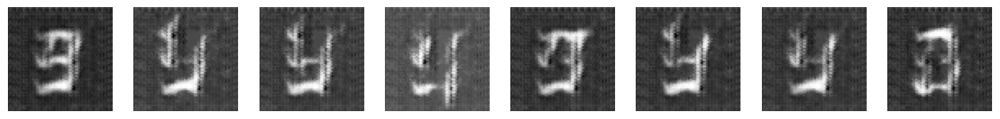

Epoch 4, Step 1871, D Loss: 0.0166, G Loss: 7.1746

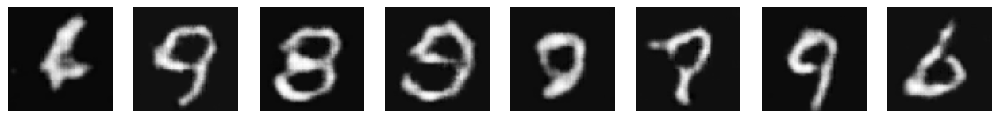

Epoch 5, Step 1871, D Loss: 0.0215, G Loss: 7.8480

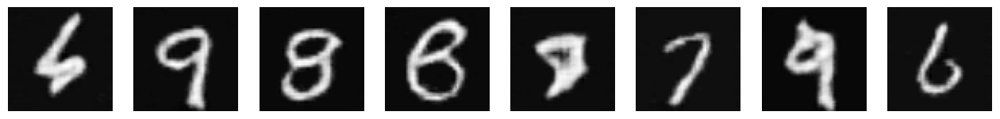

Epoch 6, Step 1871, D Loss: 0.0171, G Loss: 5.6634

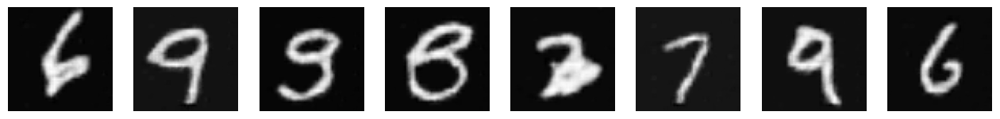

Epoch 7, Step 1871, D Loss: 0.3112, G Loss: 4.2007

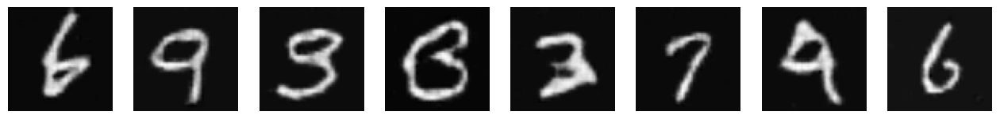

Epoch 8, Step 1871, D Loss: 0.0329, G Loss: 12.5693

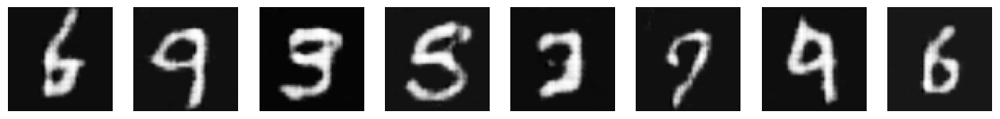

Epoch 9, Step 1871, D Loss: 0.0485, G Loss: 2.4006

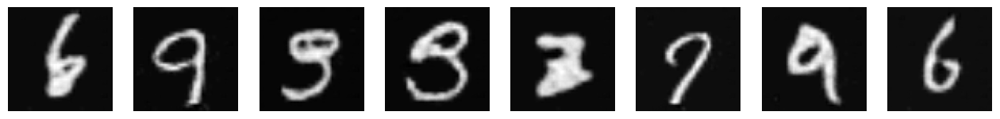

Epoch 10, Step 1871, D Loss: 0.1634, G Loss: 5.6623

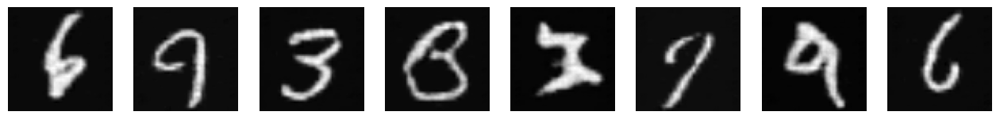

Epoch 11, Step 1871, D Loss: 0.0063, G Loss: 8.6854

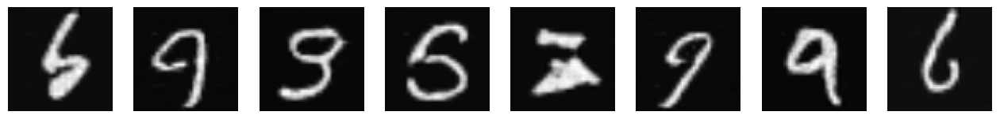

Epoch 12, Step 1871, D Loss: 0.0205, G Loss: 5.3910

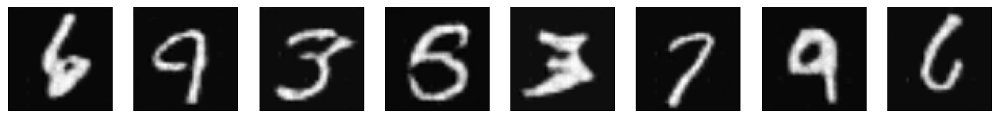

Epoch 13, Step 1871, D Loss: 1.8584, G Loss: 4.3952

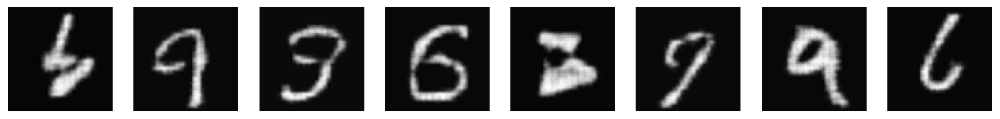

Epoch 14, Step 1871, D Loss: 0.0032, G Loss: 7.7274

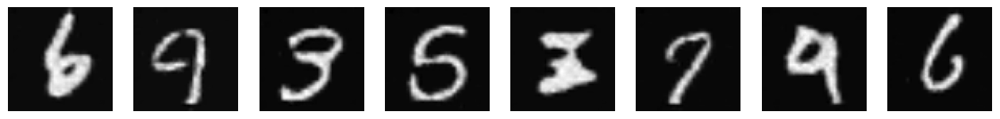

Epoch 15, Step 1871, D Loss: 0.0008, G Loss: 6.1225

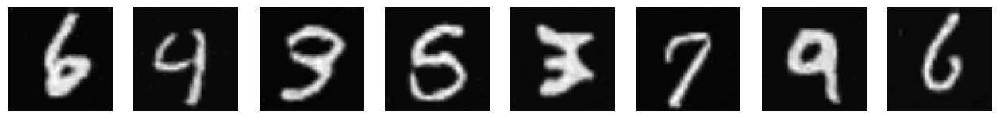

Epoch 16, Step 1871, D Loss: 0.0424, G Loss: 5.6016

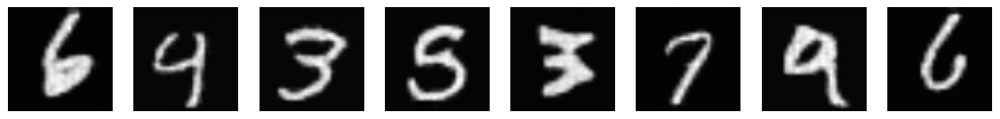

Epoch 17, Step 1871, D Loss: 0.0034, G Loss: 8.0767

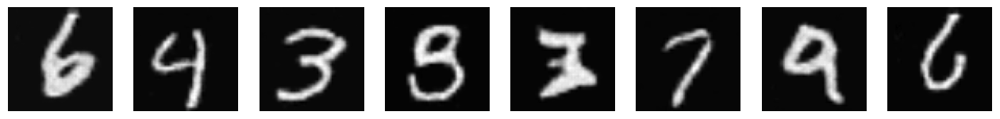

Epoch 18, Step 1871, D Loss: 0.0034, G Loss: 8.6057

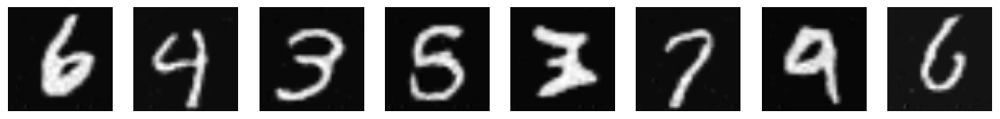

Epoch 19, Step 1871, D Loss: 0.0070, G Loss: 7.3560

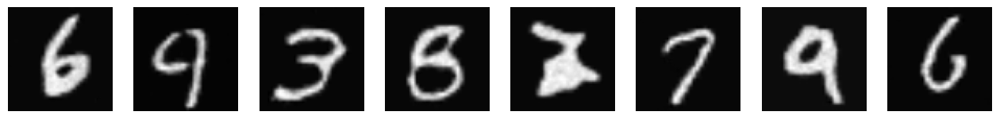

Epoch 20, Step 1871, D Loss: 0.0032, G Loss: 5.4552

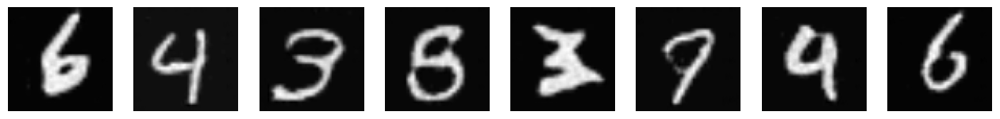

In [17]:
num_epochs = 20
batch_size = 32
z_dim = 100
criterion = nn.BCELoss()

generator = Generator().cuda()
discriminator = Discriminator().cuda()

# Define optimizer
d_optimizer = torch.optim.Adam(discriminator.parameters(),lr=0.0002)
g_optimizer = torch.optim.Adam(generator.parameters(),lr=0.0002)

# To generate a few images after each epoch
fixed_z = Variable(torch.randn(batch_size, z_dim)).cuda()

for epoch in range(num_epochs):
    for i, (images, _) in enumerate(data_loader):
        images = images.cuda()
        z = Variable(torch.randn(batch_size, z_dim)).cuda()
        real_labels = torch.ones(batch_size, 1).cuda()
        fake_labels = torch.zeros(batch_size, 1).cuda()

        # Train Discriminator
        fake_image = generator(z)
        d_loss = train_discriminator(discriminator, images, real_labels, fake_image, fake_labels, criterion, d_optimizer)

        # Train Generator
        z = Variable(torch.randn(batch_size, z_dim)).cuda()
        fake_image = generator(z)
        g_loss = train_generator(discriminator, fake_image, real_labels, criterion, g_optimizer)

        if i % 10 == 0:
            print(f'\rEpoch {epoch+1}, Step {i+1}, D Loss: {d_loss:.4f}, G Loss: {g_loss:.4f}',end='')

    # Generate and save a few fake images
    save_fake_images(epoch+1, generator, fixed_z, batch_size, z_dim)

<br><br><br><br><br><br><br><br>

# Part 2: Implementation of a Conditional GAN (CGAN)

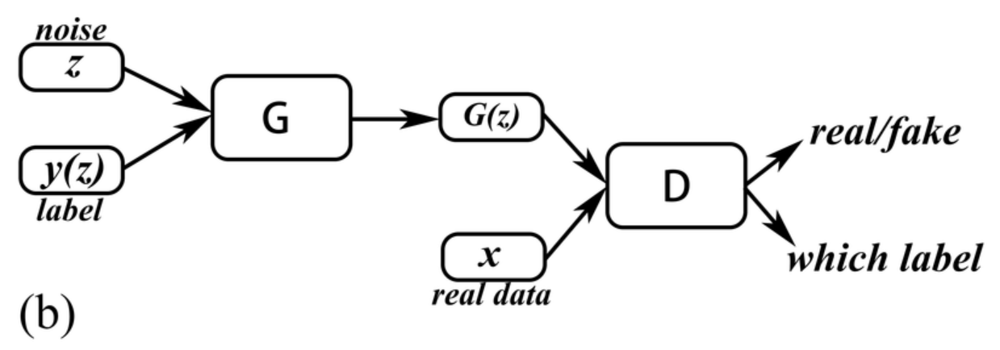

In this section, we will implement a Conditional Generative Adversarial Network (CGAN) to generate fake images of handwritten digits, conditioned on their labels, using the MNIST dataset. This means that we can generate images of specific digits by providing the desired digit label as input to the generator.

The main components of this CGAN include:

1. **Data Preprocessing**: Loading the MNIST dataset with labels and applying necessary transformations.
2. **Generator**: A neural network that takes random noise and a digit label as input and generates an image.
3. **Discriminator**: A neural network that takes an image and a digit label as input and classifies it as real or fake.
4. **Training Loop**: Training the generator and discriminator in alternating steps, taking the digit labels into account.
5. **Results**: Visualizing the generated images conditioned on labels and logging the training process.


In [38]:
class ConditionalBlock(nn.Module):
    def __init__(self, in_feat, out_feat, normalize=True):
        super(ConditionalBlock, self).__init__()
        layers = [nn.Linear(in_feat, out_feat)]
        if normalize:
            layers.append(nn.BatchNorm1d(out_feat, 0.8))
        layers.append(nn.LeakyReLU(0.2, inplace=True))
        self.seq = nn.Sequential(*layers)

    def forward(self, x):
        return self.seq(x)

class ConditionalGenerator(nn.Module):
    def __init__(self, z_dim=100, label_dim=10):
        super(ConditionalGenerator, self).__init__()
        self.label_embedding = nn.Embedding(label_dim, label_dim)
        self.model = nn.Sequential(
            # Hint: Use Linear, BatchNorm1d and proper activation layers
            # Hint: The first layer is given.
            # Your code here [10 score]
            ConditionalBlock(z_dim + label_dim, 128, normalize=False),
            ConditionalBlock(128, 256),
            ConditionalBlock(256, 512),
            ConditionalBlock(512, 1024),
            nn.Linear(1024, 64 * 64),
            nn.Tanh()

        )


    def forward(self, noise, labels):
        labels = self.label_embedding(labels)
        labels = labels.view(labels.size(0), -1)
        gen_input = torch.cat((noise, labels), 1)  # Concatenate along the feature dimension
        img = self.model(gen_input)
        img = img.view(img.size(0), 1, 64, 64)
        return img

In [39]:
class ConditionalDiscriminator(nn.Module):
    def __init__(self, label_dim=10):
        super(ConditionalDiscriminator, self).__init__()
        self.label_embedding = nn.Embedding(label_dim, label_dim)
        self.model = nn.Sequential(
            # Hint: Use Linear, BatchNorm1d and proper activation layers
            # Hint: You may need use Dropout layers
            # Your code here [10 score]
            nn.Linear(label_dim + 64 * 64, 512),
            nn.LeakyReLU(0.2, inplace=True),

            nn.Linear(512, 512),
            nn.Dropout(0.4),
            nn.LeakyReLU(0.2, inplace=True),

            nn.Linear(512, 512),
            nn.Dropout(0.4),
            nn.LeakyReLU(0.2, inplace=True),

            nn.Linear(512, 1),
            nn.Sigmoid()
        )

    def forward(self, img, labels):
        # Concatenate label embedding and image to produce input
        d_in = torch.cat((img.view(img.size(0), -1), self.label_embedding(labels)), -1)
        validity = self.model(d_in)
        return validity

In [40]:
# Initialize generator and discriminator
generator = ConditionalGenerator().cuda()
discriminator = ConditionalDiscriminator().cuda()

# Loss functions
adversarial_loss = torch.nn.BCELoss()

# Optimizers
optimizer_G = torch.optim.Adam(generator.parameters(), lr=0.0002, betas=(0.5, 0.999))
optimizer_D = torch.optim.Adam(discriminator.parameters(), lr=0.0002, betas=(0.5, 0.999))

In [41]:
def save_fake_labled_images(epoch=0):
    sample_path = 'cgan/'
    if not os.path.exists(sample_path):
        os.makedirs(sample_path)

    sample_labels = torch.arange(10).type(torch.LongTensor).cuda()
    z = torch.randn(10, 100).cuda()
    gen_imgs = generator(z, sample_labels)

    fig, axs = plt.subplots(1, 10, figsize=(18, 2))

    for i in range(10):
        img = gen_imgs[i].cpu().detach().squeeze().numpy()
        img = (img + 1) / 2
        img = np.clip(img, 0, 1)

        axs[i].imshow(img, cmap='gray')
        axs[i].set_title(f"Label: {i}")
        axs[i].axis('off')

    plt.tight_layout()
    plt.savefig(sample_path + f"generated_images_with_labels_{epoch}.png")
    plt.show()

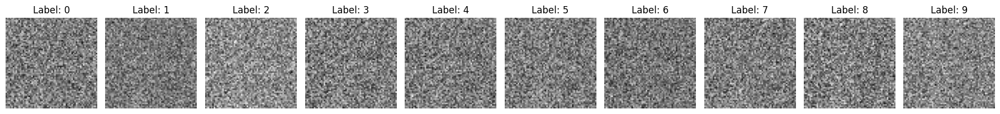

In [42]:
save_fake_labled_images(epoch=0)

Epoch 1, Step 1871, D Loss: 0.8022, G Loss: 0.8124

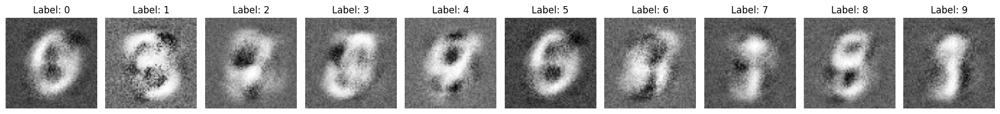

Epoch 2, Step 1871, D Loss: 0.3513, G Loss: 2.7437

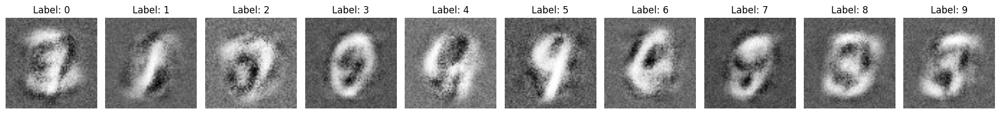

Epoch 3, Step 1871, D Loss: 0.4576, G Loss: 1.8252

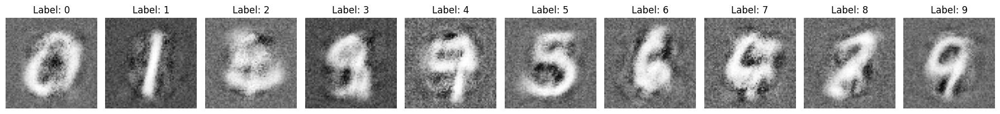

Epoch 4, Step 1871, D Loss: 0.1878, G Loss: 2.5369

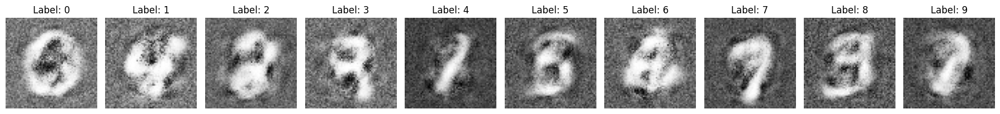

Epoch 5, Step 1871, D Loss: 0.3747, G Loss: 2.3692

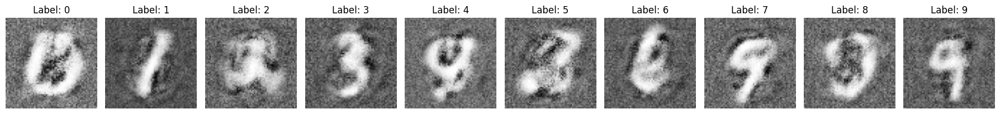

Epoch 6, Step 1871, D Loss: 0.2391, G Loss: 2.1089

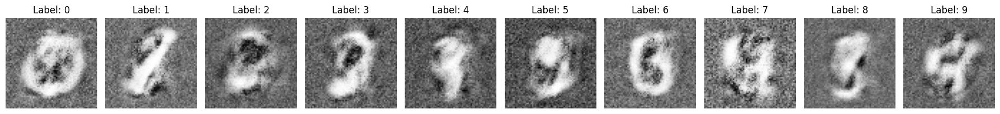

Epoch 7, Step 1871, D Loss: 0.3146, G Loss: 2.0242

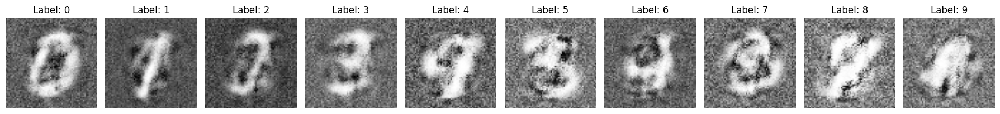

Epoch 8, Step 1871, D Loss: 0.3836, G Loss: 2.4474

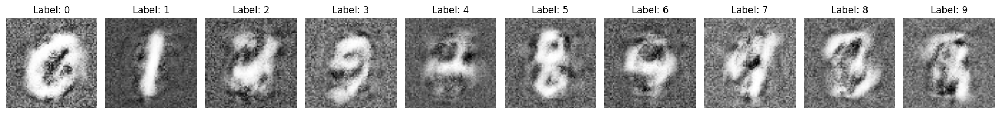

Epoch 9, Step 1871, D Loss: 0.1703, G Loss: 3.4137

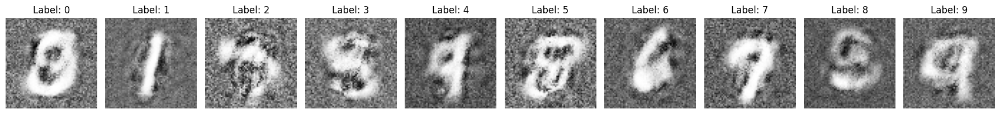

Epoch 10, Step 1871, D Loss: 0.3157, G Loss: 3.1925

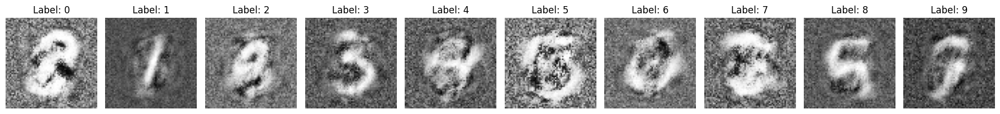

Epoch 11, Step 1871, D Loss: 0.9296, G Loss: 5.6086

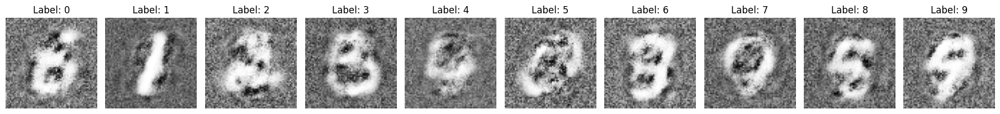

Epoch 12, Step 1871, D Loss: 0.6006, G Loss: 2.4294

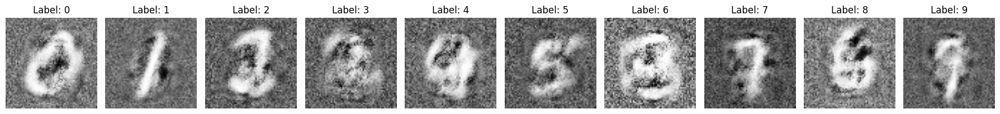

Epoch 13, Step 1871, D Loss: 0.8942, G Loss: 1.0014

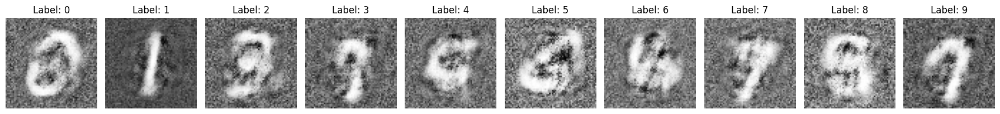

Epoch 14, Step 1871, D Loss: 0.3615, G Loss: 2.9279

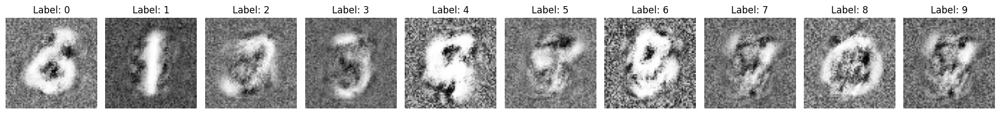

Epoch 15, Step 1871, D Loss: 0.3895, G Loss: 2.2682

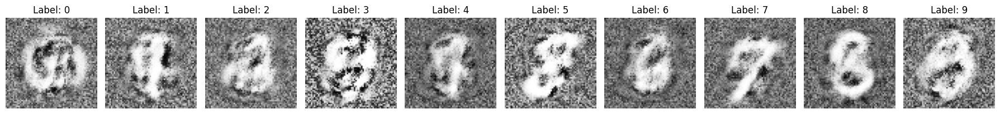

Epoch 16, Step 1871, D Loss: 0.8015, G Loss: 1.8825

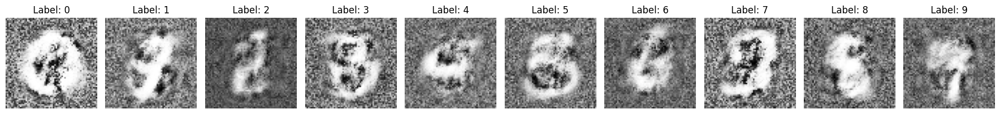

Epoch 17, Step 1871, D Loss: 0.4689, G Loss: 2.9182

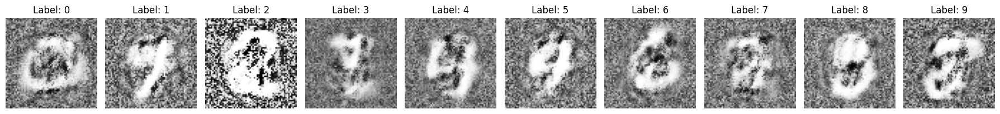

Epoch 18, Step 1871, D Loss: 0.2232, G Loss: 3.9859

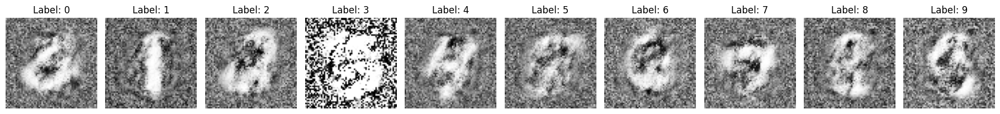

Epoch 19, Step 1871, D Loss: 0.3878, G Loss: 3.3768

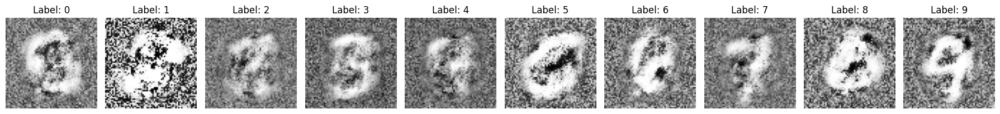

Epoch 20, Step 1871, D Loss: 0.0641, G Loss: 3.5482

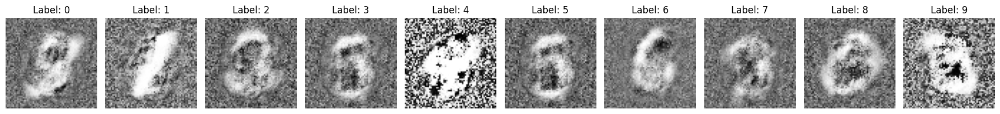

Epoch 21, Step 1871, D Loss: 0.4477, G Loss: 4.3783

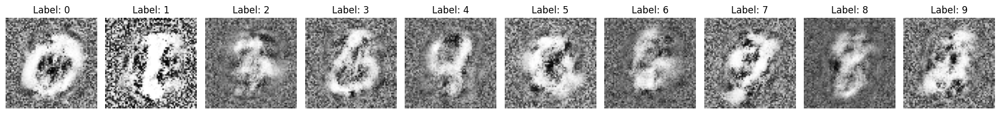

Epoch 22, Step 1871, D Loss: 0.0788, G Loss: 3.9972

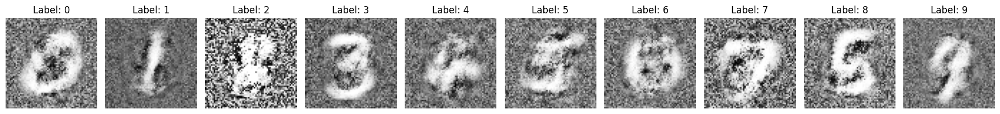

Epoch 23, Step 1871, D Loss: 0.6896, G Loss: 4.1625

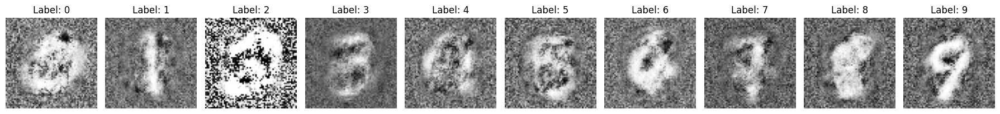

Epoch 24, Step 1871, D Loss: 0.2406, G Loss: 3.9528

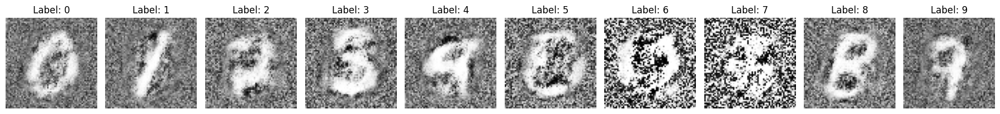

Epoch 25, Step 1871, D Loss: 0.7057, G Loss: 4.6115

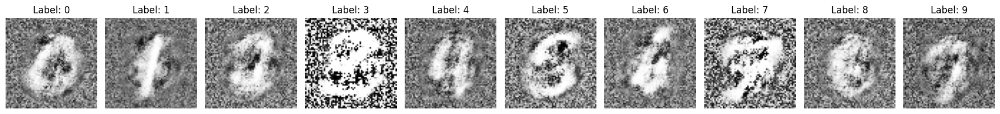

Epoch 26, Step 1871, D Loss: 0.2369, G Loss: 3.1402

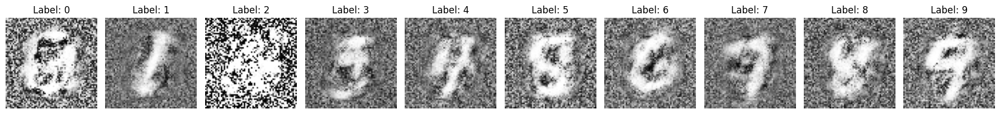

Epoch 27, Step 1871, D Loss: 0.1106, G Loss: 4.1186

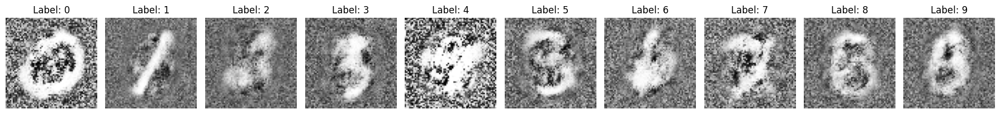

Epoch 28, Step 1871, D Loss: 0.4346, G Loss: 3.2047

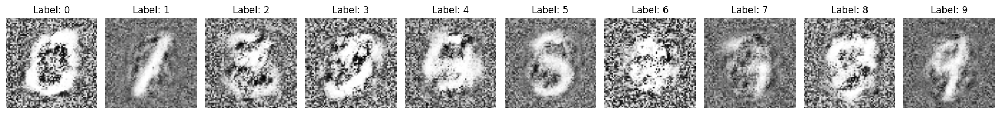

Epoch 29, Step 1871, D Loss: 0.3942, G Loss: 2.7666

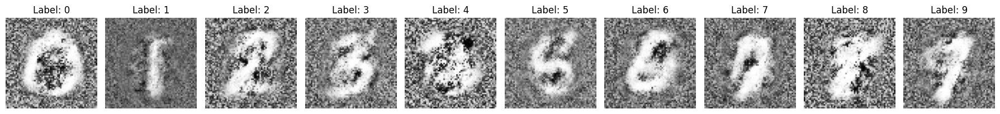

Epoch 30, Step 1871, D Loss: 0.4220, G Loss: 2.7734

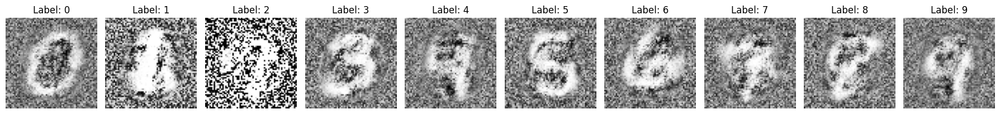

Epoch 31, Step 1871, D Loss: 0.1630, G Loss: 2.6862

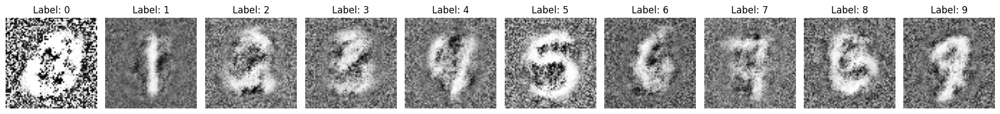

Epoch 32, Step 1871, D Loss: 0.1097, G Loss: 3.3252

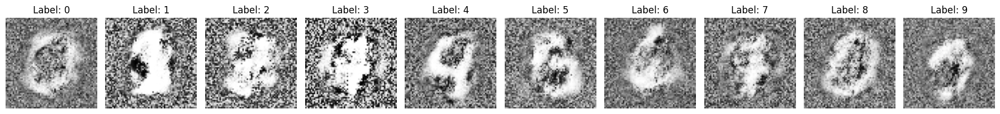

Epoch 33, Step 1871, D Loss: 0.3334, G Loss: 3.1042

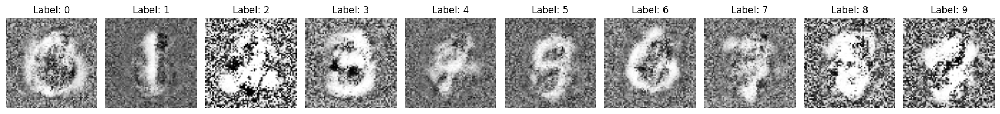

Epoch 34, Step 1871, D Loss: 0.1417, G Loss: 5.9938

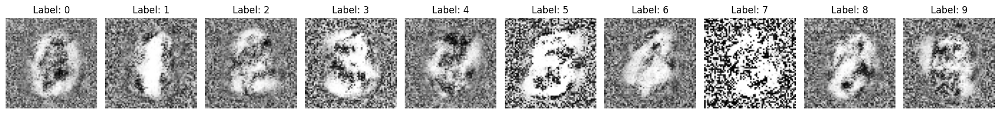

Epoch 35, Step 1871, D Loss: 0.2388, G Loss: 2.8678

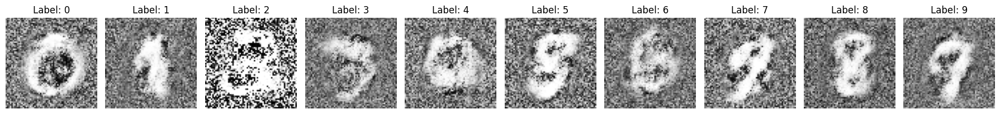

Epoch 36, Step 1871, D Loss: 0.2214, G Loss: 3.7991

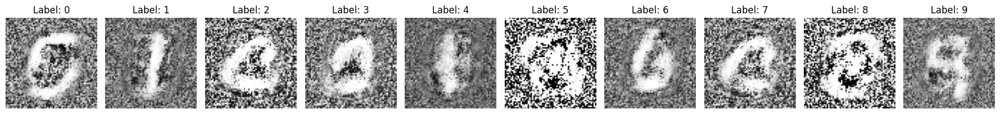

Epoch 37, Step 1871, D Loss: 0.1494, G Loss: 3.6636

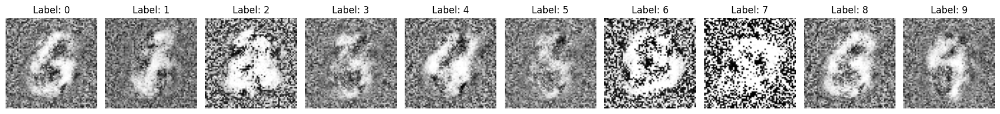

Epoch 38, Step 1871, D Loss: 0.0928, G Loss: 3.5568

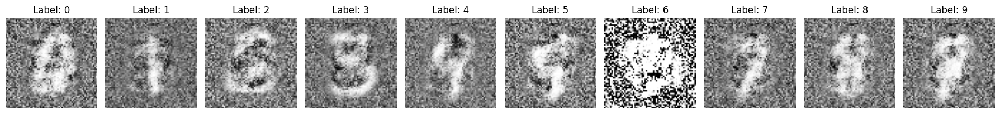

Epoch 39, Step 1871, D Loss: 0.0719, G Loss: 5.1729

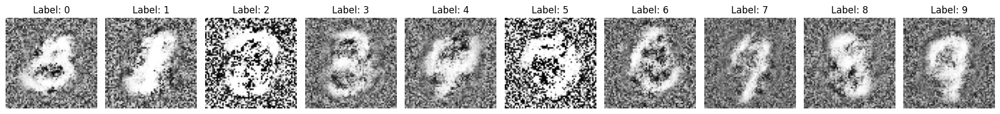

Epoch 40, Step 1871, D Loss: 0.2076, G Loss: 3.9710

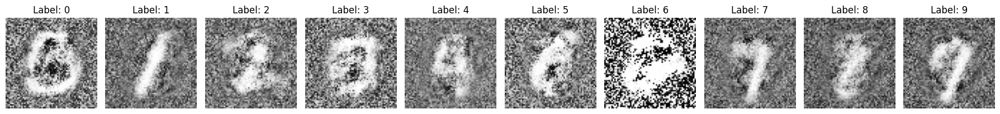

Epoch 41, Step 1871, D Loss: 0.0836, G Loss: 3.2205

Exception ignored in: <function _xla_gc_callback at 0x79360ea95480>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/jax/_src/lib/__init__.py", line 97, in _xla_gc_callback
    def _xla_gc_callback(*args):
KeyboardInterrupt: 


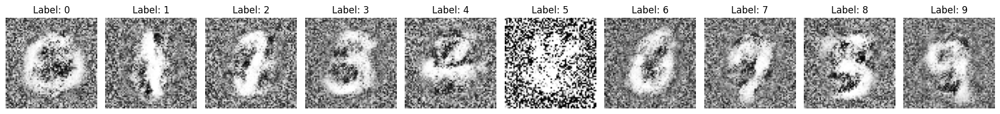

Epoch 42, Step 341, D Loss: 0.3595, G Loss: 5.3550

KeyboardInterrupt: 

In [47]:
num_epochs = 20 #change it if you need

# Labels for generated images
sample_labels = torch.randint(0, 10, (32,)).type(torch.LongTensor).cuda()

for epoch in range(200):
    for i, (imgs, labels) in enumerate(data_loader):

        batch_size = imgs.shape[0]

        # Adversarial ground truths
        valid = torch.ones(batch_size, 1).cuda()
        fake = torch.zeros(batch_size, 1).cuda()

        imgs = imgs.to("cuda")
        labels = labels.to("cuda")

        # Train Generator
        optimizer_G.zero_grad()

        # Hint: Sample noise and labels. Generate a batch of images and calculate and backpropagate g_loss
        # Your code here [10 score]
        z = torch.FloatTensor(np.random.normal(0, 1, (batch_size, 100))).cuda()
        gen_labels = torch.LongTensor(np.random.randint(0, 10, batch_size)).cuda()

        # Generate a batch of images
        gen_imgs = generator(z, gen_labels)

        # Loss measures generator's ability to fool the discriminator
        validity = discriminator(gen_imgs, gen_labels)
        g_loss = adversarial_loss(validity, valid)

        g_loss.backward()
        optimizer_G.step()


        # Train Discriminator
        optimizer_D.zero_grad()

        # Hint: Pass real and fake images to discriminator and backporpagate sum of real and fake losses
        # Your code here [10 score]
        validity_real = discriminator(imgs, labels)
        d_real_loss = adversarial_loss(validity_real, valid)

        # Loss for fake images
        validity_fake = discriminator(gen_imgs.detach(), gen_labels)
        d_fake_loss = adversarial_loss(validity_fake, fake)

        # Total discriminator loss
        d_loss = d_real_loss + d_fake_loss

        d_loss.backward()
        optimizer_D.step()


        # Save training progress
        if i % 10 == 0:
            print(f'\rEpoch {epoch+1}, Step {i+1}, D Loss: {d_loss:.4f}, G Loss: {g_loss:.4f}', end='')

    save_fake_labled_images(epoch)

**Question:** [10 score]

With learned insights from the notebook, compare Conditional Generative Adversarial Networks (CGANs) and traditional Generative Adversarial Networks (GANs) in terms of architecture, input data, loss functions, and potential applications.

## Answer
Conditional Generative Adversarial Networks (CGANs) and traditional Generative Adversarial Networks (GANs) are both architectures for training deep learning-based generative models. However, CGANs differ from GANs in that they are conditioned on additional information, such as class labels or data from other modalities, which allows for more precise and targeted data generation[1][5][7].

In terms of architecture, both CGANs and GANs consist of two main components: a generator and a discriminator. The generator learns to generate plausible data, while the discriminator learns to distinguish the generator's fake data from real data[2][3][4][10]. However, in CGANs, the generator is conditioned on additional information, which is fed into the network as an additional input layer to the discriminator and the generator[7][11].

In terms of input data, GANs take random noise as input, while CGANs take additional information, such as class labels or data from other modalities, as input[1][5][7].

In terms of loss functions, both CGANs and GANs use adversarial loss, which is the difference between the predicted output and the true output. However, CGANs also use conditional loss, which measures the difference between the generated output and the target output[1][3].

In terms of potential applications, both CGANs and GANs have been used for image generation, video generation, and text-to-image translation. However, CGANs have also been used for image-to-image translation, where images are evolved by considering additional information, such as labels[1][5][6][9].

```
Citations:
[1] https://machinelearningmastery.com/how-to-develop-a-conditional-generative-adversarial-network-from-scratch/
[2] https://developers.google.com/machine-learning/gan/gan_structure
[3] https://ch.mathworks.com/help/deeplearning/ug/train-conditional-generative-adversarial-network.html
[4] https://developers.google.com/machine-learning/gan/generator
[5] https://datascientest.com/en/what-is-a-conditional-generative-adversarial-network-cgan
[6] https://neptune.ai/blog/6-gan-architectures
[7] https://www.geeksforgeeks.org/conditional-generative-adversarial-network/
[8] https://www.toptal.com/machine-learning/generative-adversarial-networks
[9] https://towardsdatascience.com/cgan-conditional-generative-adversarial-network-how-to-gain-control-over-gan-outputs-b30620bd0cc8
[10] https://www.leewayhertz.com/generative-adversarial-networks/
[11] https://datahacker.rs/016-conditional-generative-adversarial-networks-cgans/
[12] https://stackoverflow.com/questions/44919338/do-generative-adversarial-networks-require-class-labels
[13] https://www.taskus.com/insights/cgans-101-what-is-a-conditional-generative-adversarial-network/
[14] https://datagen.tech/guides/computer-vision/gan-deep-learning/
[15] https://cfml.se/blog/cgans/
[16] https://ieeexplore.ieee.org/document/9715407
[17] https://blog.paperspace.com/conditional-generative-adversarial-networks/
[18] https://machinelearningmastery.com/what-are-generative-adversarial-networks-gans/
[19] https://towardsdatascience.com/understanding-generative-adversarial-networks-gans-cd6e4651a29
[20] https://www.mathworks.com/help/deeplearning/ug/train-conditional-generative-adversarial-network.html
[21] https://youssefh.substack.com/p/a-gentle-introduction-to-generative
[22] https://www.educative.io/answers/what-is-a-conditional-gan-cgan
[23] https://em360tech.com/tech-article/what-are-generative-adversarial-networks-GANs
[24] https://arxiv.org/pdf/2003.08936.pdf
[25] https://www.xenonstack.com/blog/gan-architecture
```
